# **Online course recommendation**

# **1. Problem Statement :**

 ### *The goal of this dataset is to build an online course recommendation system that suggests relevant courses to learners based on their interests, past enrollments, and engagement levels. The dataset includes course ratings, instructor information, previous learning history, study material availability, and certification offerings, making it suitable for recommendation models using collaborative filtering, content-based filtering, or hybrid approaches.*


# **2. Columns Description**
### <b>Attribute Information: </b>
* ### user_id: Unique identifier for each learner.
* ### course_id: Unique identifier for each online course.
* ### course_name: The name of the online course.
* ### instructor: The name of the instructor teaching the course.
* ### course_duration_hours: Duration of the course in hours (5.0 - 100.0).
* ### certification_offered: Indicates whether the course provides a certification upon completion (Yes/No).
* ### difficulty_level: The difficulty level of the course (Beginner, Intermediate, Advanced).
* ### rating: User-provided rating for the course (1.0 - 5.0).
* ### enrollment_numbers: The total number of students enrolled in the course.
* ### course_price: The price of the online course (20.0 - 500.0).
* ### feedback_score: A normalized score representing the feedback sentiment from students (0.0 - 1.0).
* ### study_material_available: Indicates whether additional study materials are available (Yes/No).
* ### time_spent_hours: The average time students spend on the course (1.0 - 100.0).
* ### previous_courses_taken: The number of previous courses the learner has taken before enrolling in this one.

# **3. Importing modules and required libraries**

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# **4. Loading data set**

In [23]:
df = pd.read_excel("online_course_recommendation_v2.xlsx")

# **5. Understanding the data**

In [24]:
df.head()

,user_id,course_id,course_name,instructor,course_duration_hours,certification_offered,difficulty_level,rating,enrollment_numbers,course_price,feedback_score,study_material_available,time_spent_hours,previous_courses_taken
0,15796,9366,Python for Beginners,Emma Harris,39.1,Yes,Beginner,5.0,21600,317.50,0.797,Yes,17.60,4
1,861,1928,Cybersecurity for Professionals,Alexander Young,36.3,Yes,Beginner,4.3,15379,40.99,0.770,Yes,28.97,9
2,38159,9541,DevOps and Continuous Deployment,Dr. Mia Walker,13.4,Yes,Beginner,3.9,6431,380.81,0.772,Yes,52.44,4
3,44733,3708,Project Management Fundamentals,Benjamin Lewis,58.3,Yes,Beginner,3.1,48245,342.80,0.969,No,22.29,6
4,11285,3361,Ethical Hacking Masterclass,Daniel White,30.8,Yes,Beginner,2.8,34556,381.01,0.555,Yes,22.01,5


### **Returns first 5 rows of the data set**

In [25]:
df.shape

(100000, 14)

### **the shape is (100000, 14) i.e the dataset contains 100000 rows and 14 columns**

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 14 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   user_id                   100000 non-null  int64  
 1   course_id                 100000 non-null  int64  
 2   course_name               100000 non-null  object 
 3   instructor                100000 non-null  object 
 4   course_duration_hours     100000 non-null  float64
 5   certification_offered     100000 non-null  object 
 6   difficulty_level          100000 non-null  object 
 7   rating                    100000 non-null  float64
 8   enrollment_numbers        100000 non-null  int64  
 9   course_price              100000 non-null  float64
 10  feedback_score            100000 non-null  float64
 11  study_material_available  100000 non-null  object 
 12  time_spent_hours          100000 non-null  float64
 13  previous_courses_taken    100000 non-null  in

### **The above cell returns info about all the columns like datatypes and not null counts**

In [27]:
df.describe()

,user_id,course_id,course_duration_hours,rating,enrollment_numbers,course_price,feedback_score,time_spent_hours,previous_courses_taken
count,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,24935.663570,5006.863560,52.38354,3.959859,25052.822850,261.073369,0.746865,20.691054,4.992670
std,14406.960108,2882.085456,27.42347,0.729958,14388.188356,139.013758,0.143683,13.669148,2.237259
min,1.000000,1.000000,5.00000,1.000000,50.000000,20.000000,0.092000,1.000000,0.000000
25%,12487.750000,2523.000000,28.60000,3.500000,12583.750000,140.100000,0.649000,9.900000,3.000000
50%,24793.500000,5012.000000,52.40000,4.000000,25057.500000,262.310000,0.750000,19.920000,5.000000
75%,37382.250000,7502.000000,76.10000,4.500000,37522.000000,381.702500,0.851000,30.080000,6.000000
max,49999.000000,9999.000000,100.00000,5.000000,49999.000000,500.000000,1.000000,84.150000,19.000000


### **There the numerical descrption about all the numerical columns like mean,SD etc.**

In [28]:
categorical_cols = ["course_name", "instructor","certification_offered", "difficulty_level","study_material_available"]
numerical_cols = ["user_id","course_id","course_duration_hours", "enrollment_numbers","feedback_score","course_price", "time_spent_hours", "rating","previous_courses_taken"]

### **all the columns are classified into types numerical and categorial and storede inside variables inside a list**

# **6. EDA**

### **a) Univariate analysis**

**i) Analysis of Categorical Variables using pie charts**

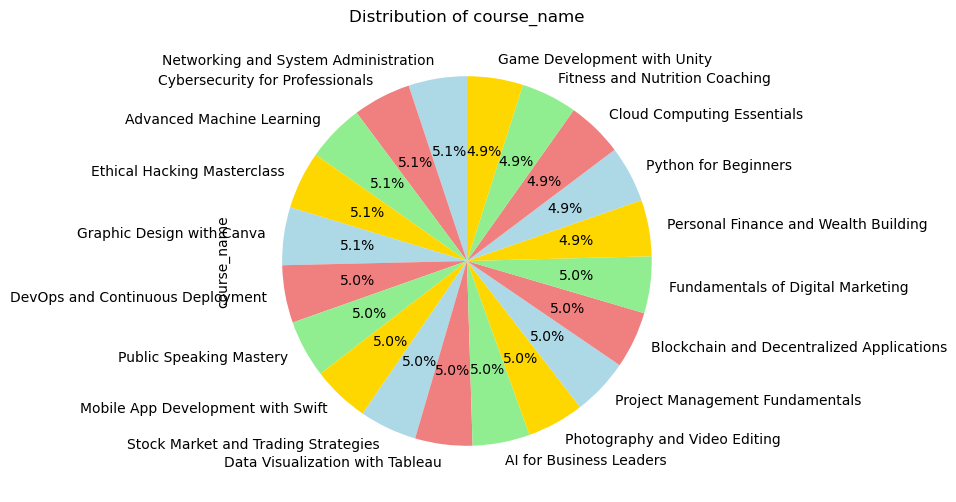

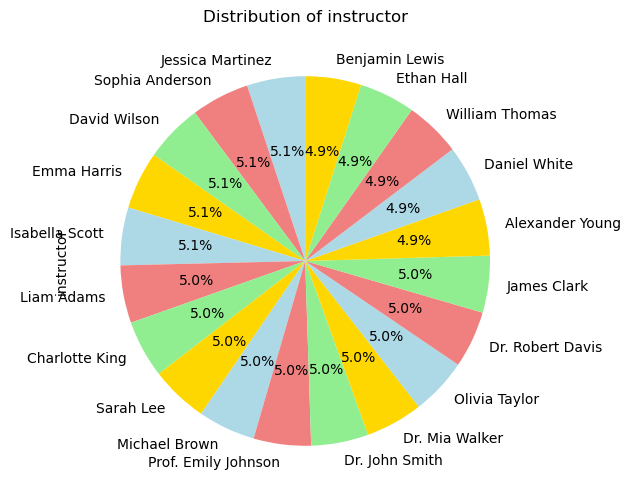

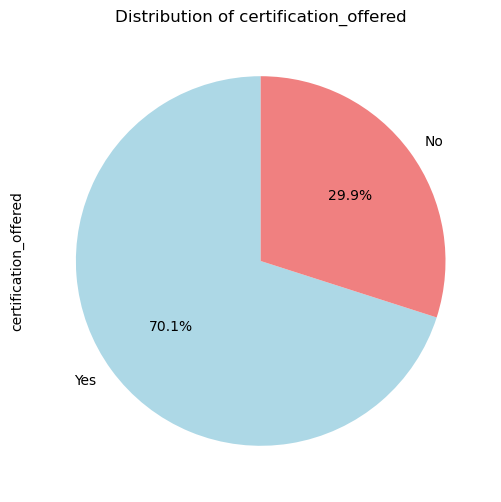

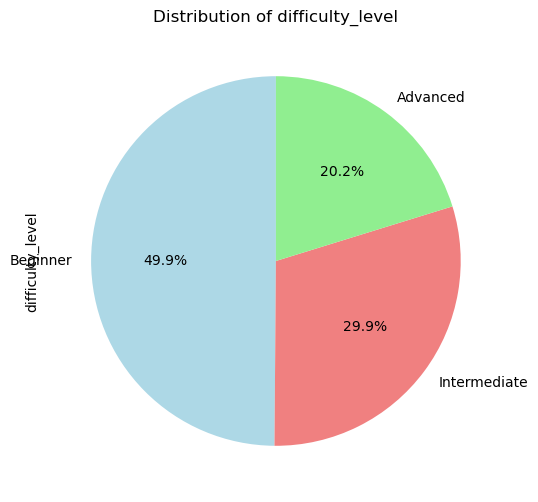

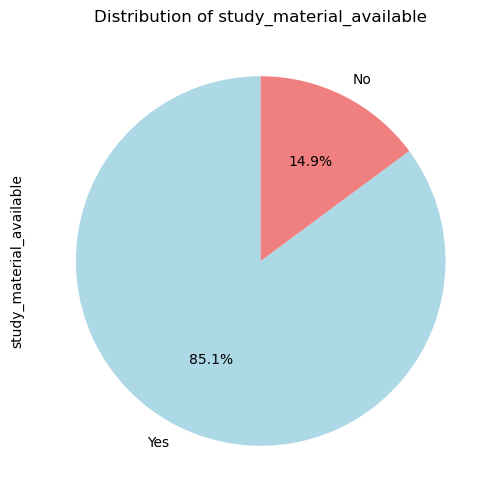

In [29]:
for i in categorical_cols:
  plt.figure(figsize=(6, 6))
  df[i].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, colors=['lightblue', 'lightcoral', 'lightgreen', 'gold'])
  plt.title(f'Distribution of {i}')
  plt.show()

# **Insights from the Pie Charts**
1️⃣ Distribution of Course Names:

* The dataset contains a diverse range of online courses, with each course making up approximately 5% of the total distribution.
* This suggests that the course offerings are well-balanced, with no single course dominating the dataset.

2️⃣ Distribution of Instructors:

* Similar to the courses, the instructors are evenly distributed, with each instructor accounting for roughly 5% of the dataset.
* This indicates that there is no significant bias toward a particular instructor.

3️⃣ Certification Offered (Yes/No):

* 70.1% of the courses offer certifications, while 29.9% do not provide certifications.
* This suggests that the majority of online courses provide learners with a certification upon completion, which could be an attractive feature for students.

4️⃣ Difficulty Level of Courses:

* 49.9% of courses are at the Beginner level, 29.9% are Intermediate, and 20.2% are Advanced.
* The majority of courses cater to beginners, indicating that the platform is more focused on entry-level learners.

5️⃣ Availability of Study Materials:

* 85.1% of courses provide study materials, while 14.9% do not.
* This suggests that most courses offer additional learning resources to support students in their studies.

**ii)Analyzing Numerical Variables Using Histograms**

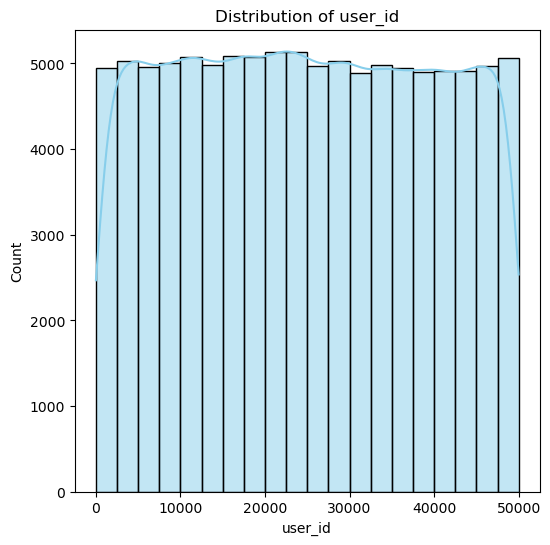

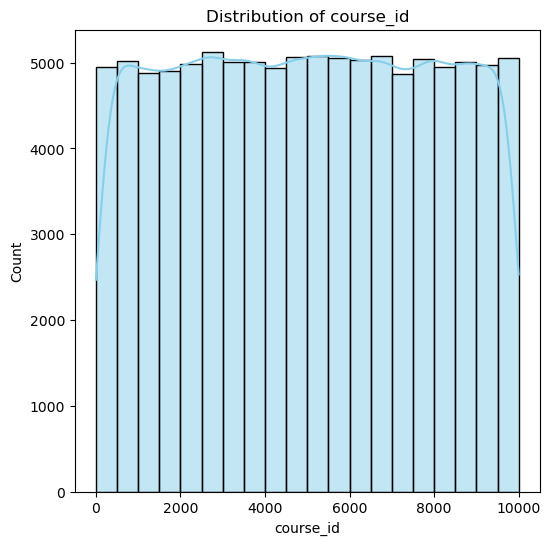

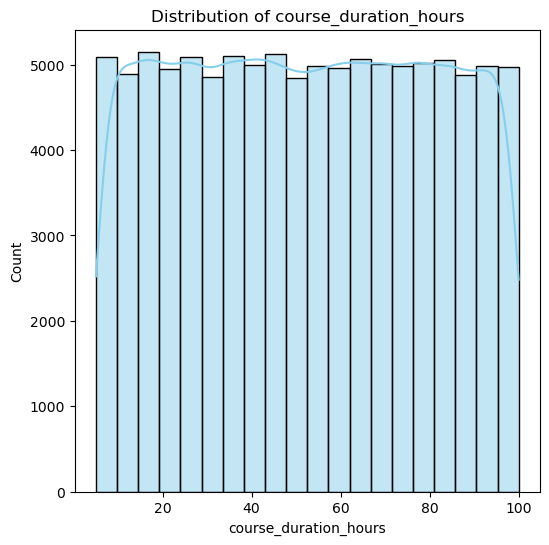

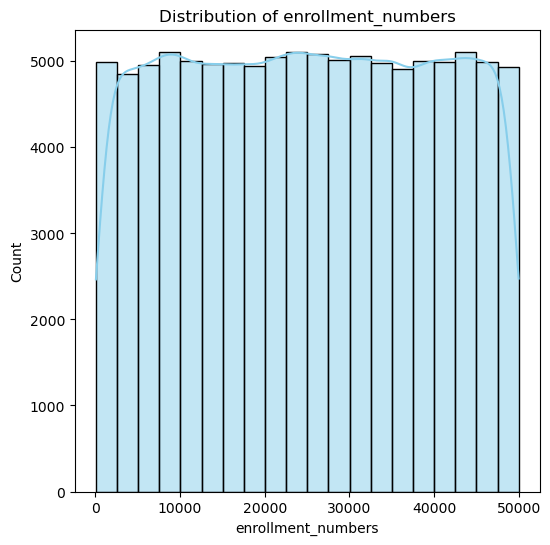

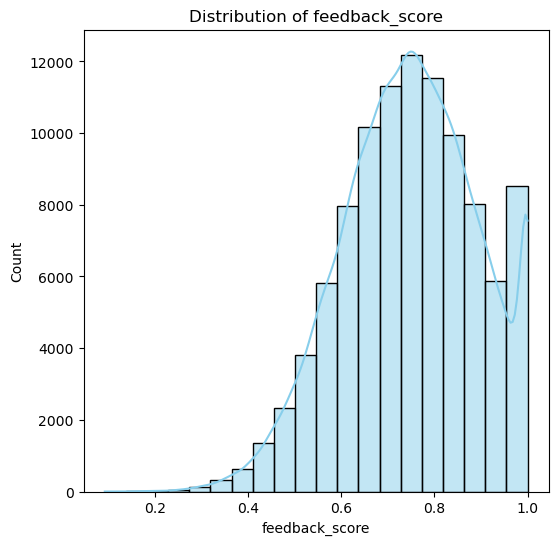

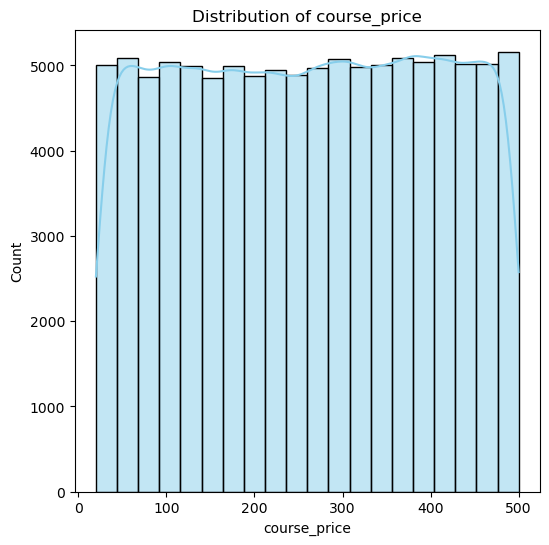

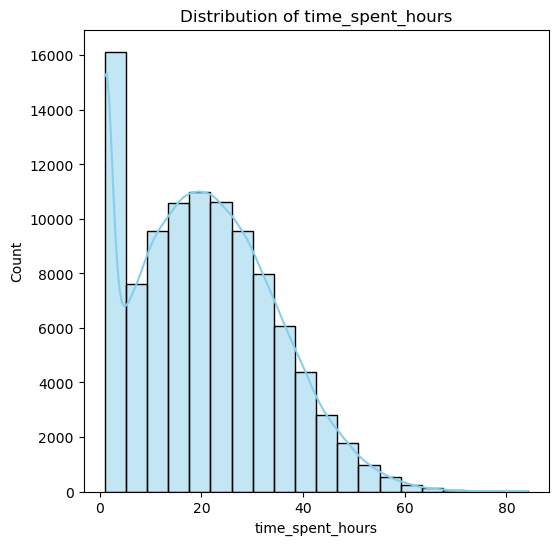

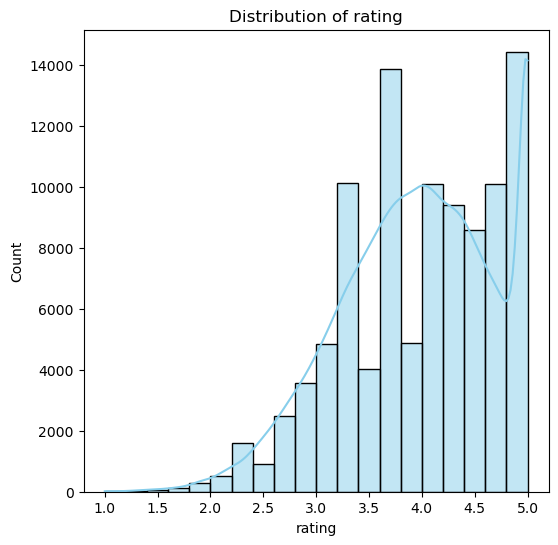

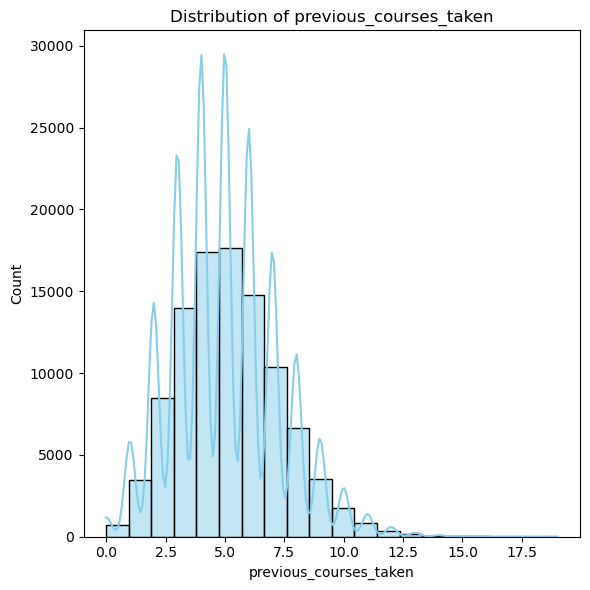

In [30]:
for col in numerical_cols:
    plt.figure(figsize=(6,6))  # Creates a grid for multiple plots
    sns.histplot(df[col], bins=20, kde=True, color="skyblue")  # KDE for smooth distribution
    plt.title(f"Distribution of {col}")

plt.tight_layout()
plt.show()

## **Insights from the Histogram**
1. Distribution of user_id:
* The histogram shows that user_id values are evenly distributed, with similar counts across different ranges. The smooth density curve follows the histogram closely, indicating a consistent spread of user IDs without major variations.
2. Distribution of course_id:
* The histogram shows that course_id values are evenly distributed, with a similar count of occurrences across different ranges. The smooth density curve follows the histogram closely, indicating a consistent distribution without significant variations.
3. Distribution of course_duration_hours:
* The histogram shows that course_duration_hours values are evenly distributed across the range, with a similar count in each bin. The smooth density curve closely follows the histogram, indicating a consistent spread without significant fluctuations.
4. Distribution of enrollment Numbers:
* The histogram shows that enrollment_numbers are evenly distributed, with similar counts across different ranges. The smooth density curve follows the histogram closely, indicating a consistent spread without major fluctuations.
5. Distribution of feedback_scores:
* The histogram shows that feedback_score values are right-skewed, with most scores concentrated between 0.6 and 0.9. The smooth density curve highlights a peak around 0.75, indicating that higher feedback scores are more common.
6. Distribution of course_prize:
* This histogram shows the distribution of course_price. The values appear to be uniformly distributed, meaning courses are priced relatively evenly across the entire range from 0 to 500.
7. Distribution of time_spent_hours:
* This histogram shows the distribution of time_spent_hours. The distribution appears to be right-skewed, meaning most users spend a lower amount of time on courses, with fewer users spending significantly more time. There's also a noticeable peak near the lower end, indicating that a large number of users spend very little time on courses.
8. Distribution of rating:
* This histogram shows the distribution of rating. The distribution is right-skewed, with a concentration of ratings in the higher range (around 4 to 5). There are some peaks at 3.5, 4.0, and 5.0, suggesting that users tend to rate courses in these common ranges. The lower end (below 2.5) has significantly fewer ratings. This pattern suggests that most users provide favorable feedback.
9. Distribution of previous_courses_taken:
* This histogram represents the distribution of previous_courses_taken. The data appears to be roughly normal, with most users having taken between 3 to 8 courses previously. There are peaks at specific points, possibly indicating that users often take courses in increments (e.g., completing a set number before moving on). The right tail suggests a few users have taken a significantly higher number of courses, but they are less common.

### **b)Bi-variate analysis**

**i)Numerical Vs Numerical**

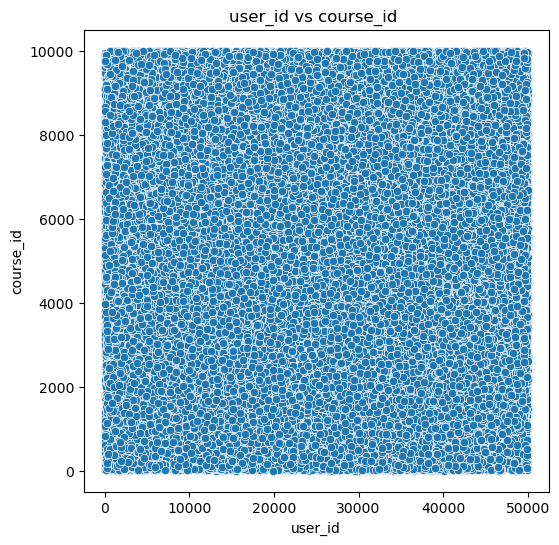

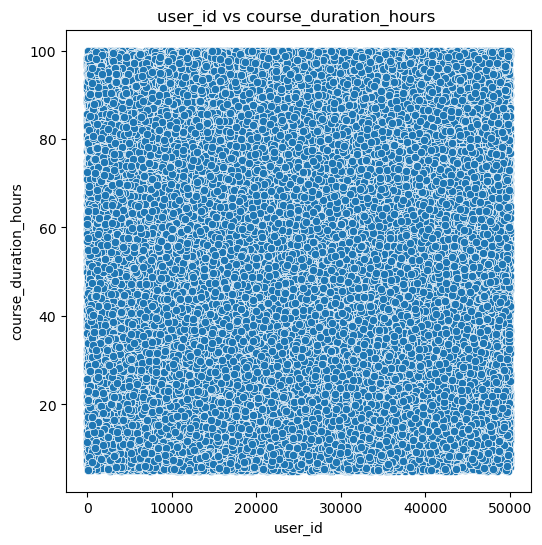

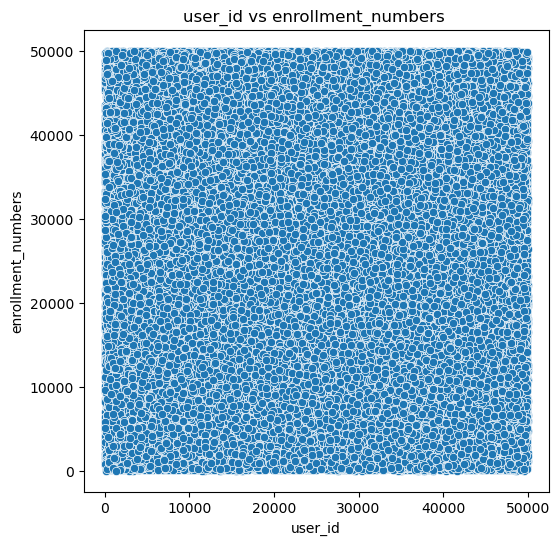

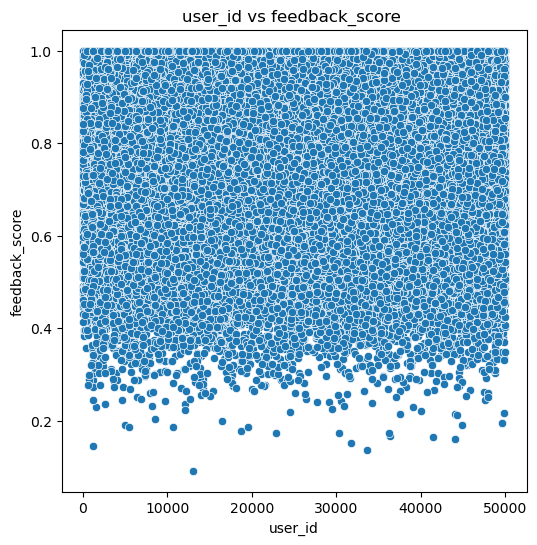

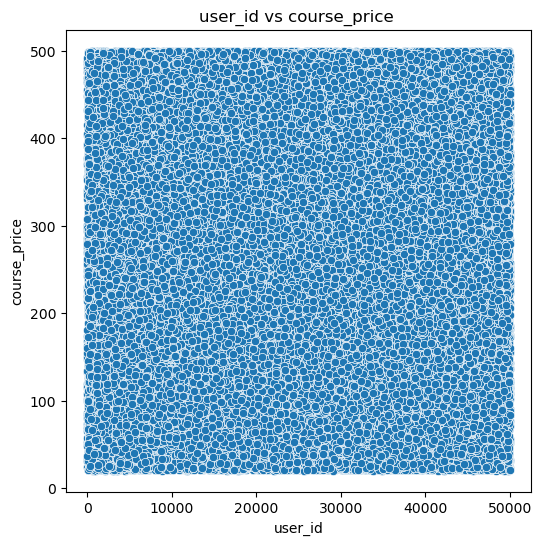

...

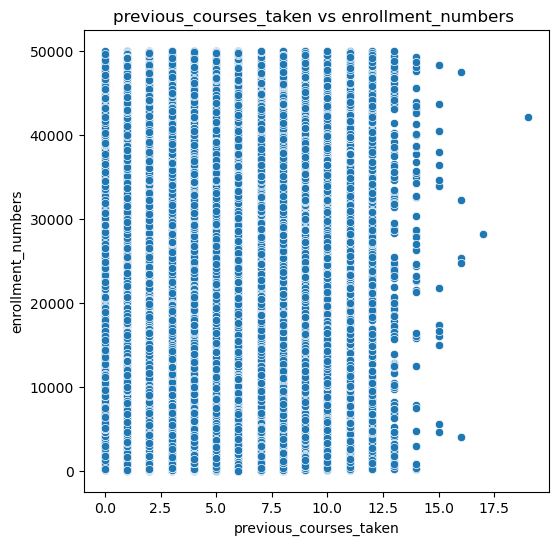

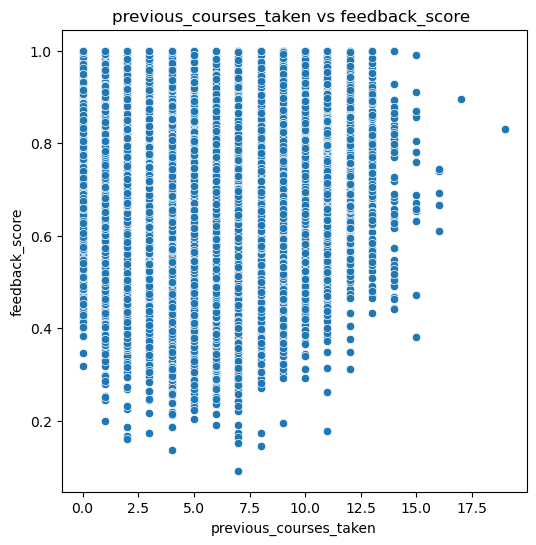

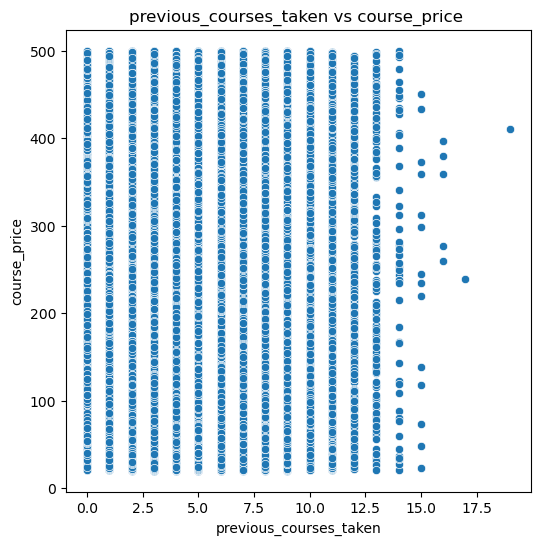

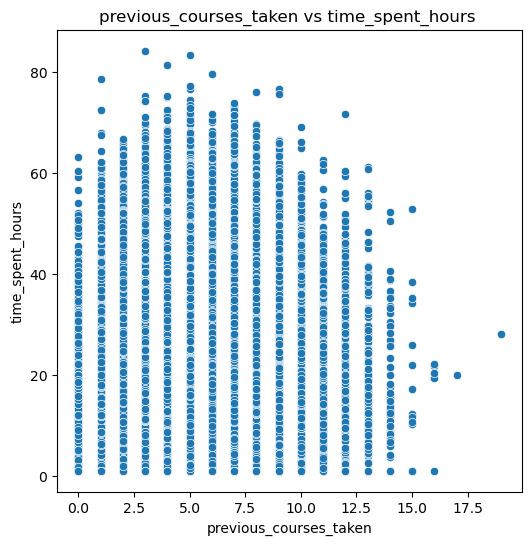

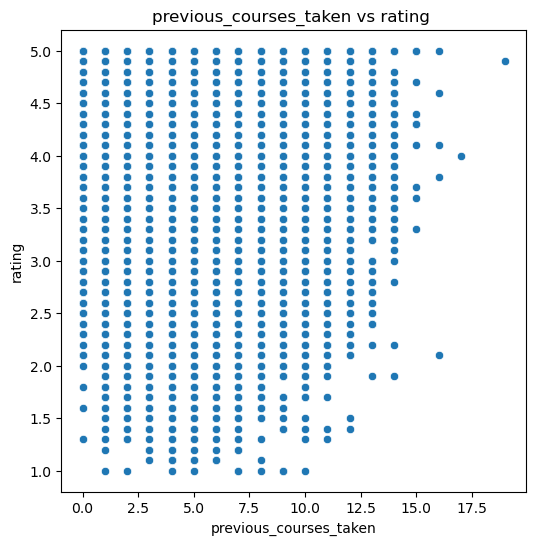

In [31]:
for i in numerical_cols:
  for j in numerical_cols:
    if i!=j:
      plt.figure(figsize=(6,6))
      sns.scatterplot(x=i,y=j,data=df)
      plt.title(f"{i} vs {j} ")
      plt.show()

**ii) Categorical Vs Numerical**

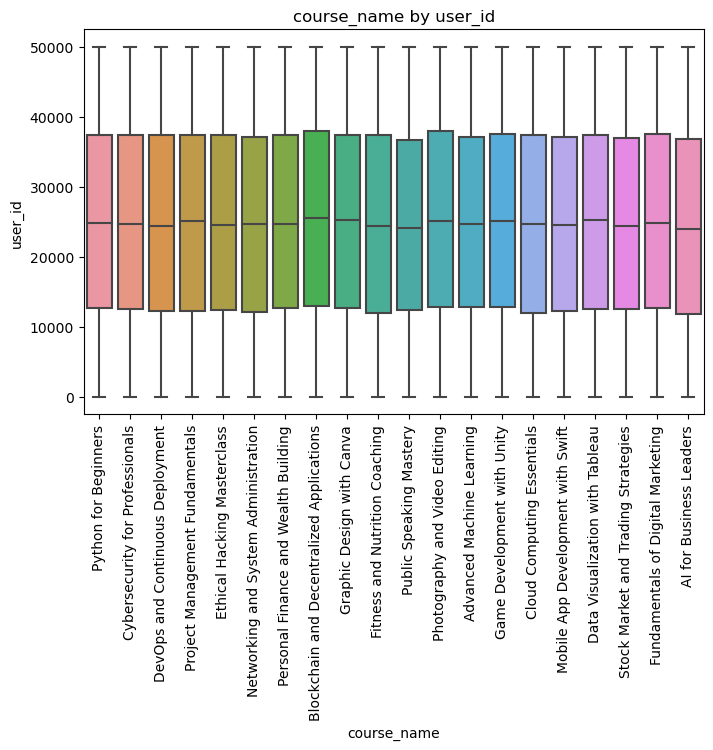

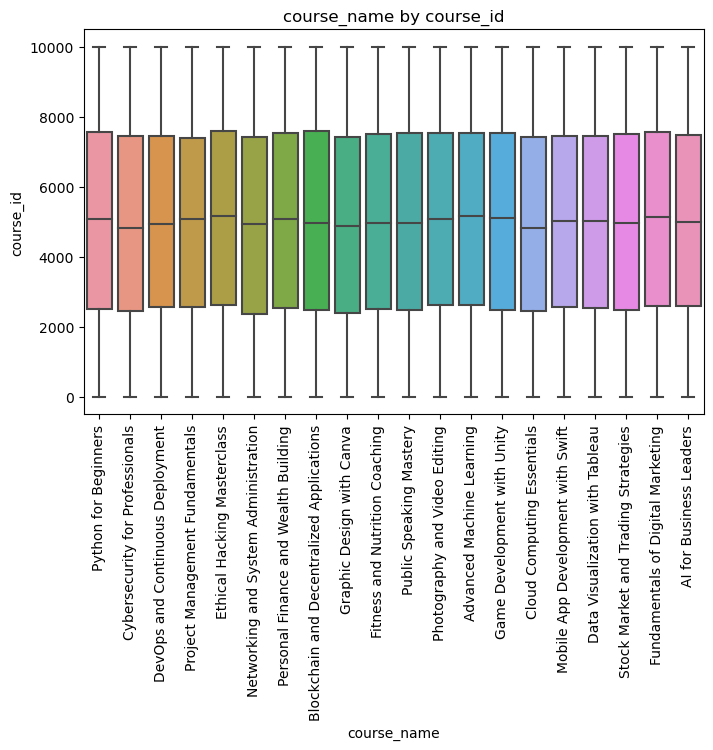

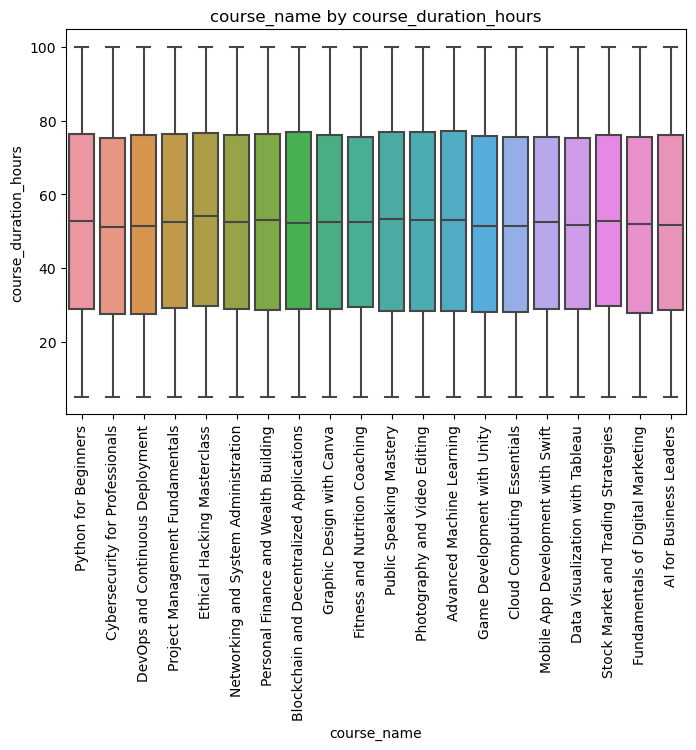

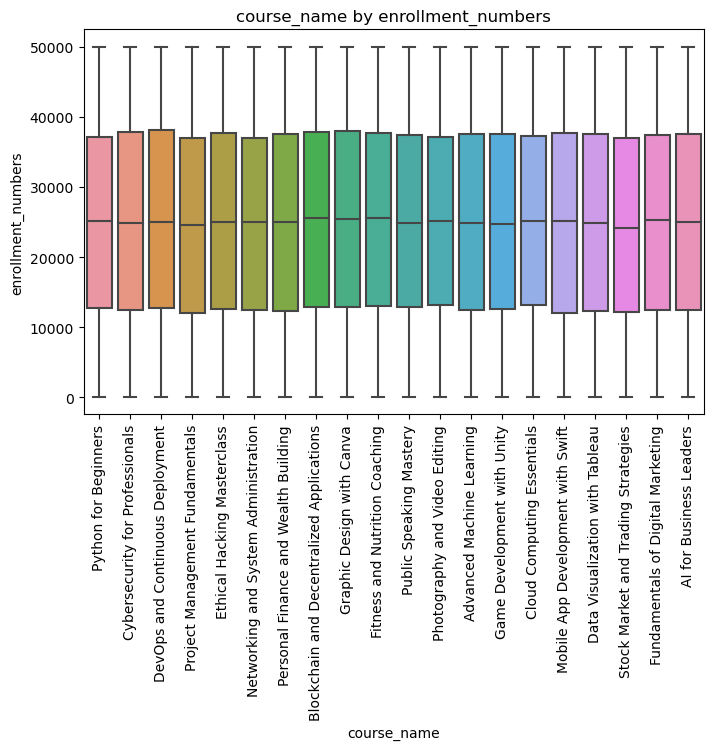

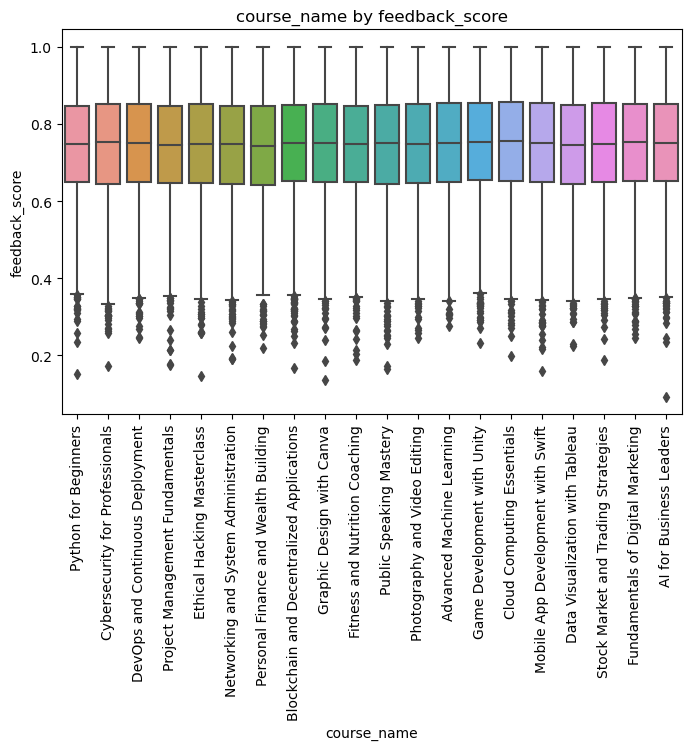

...

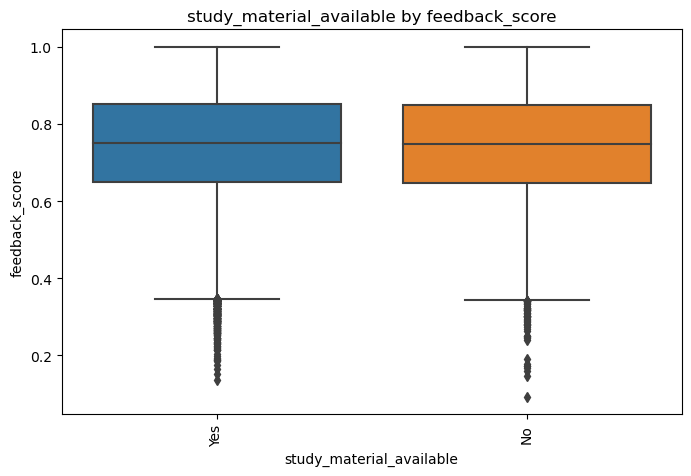

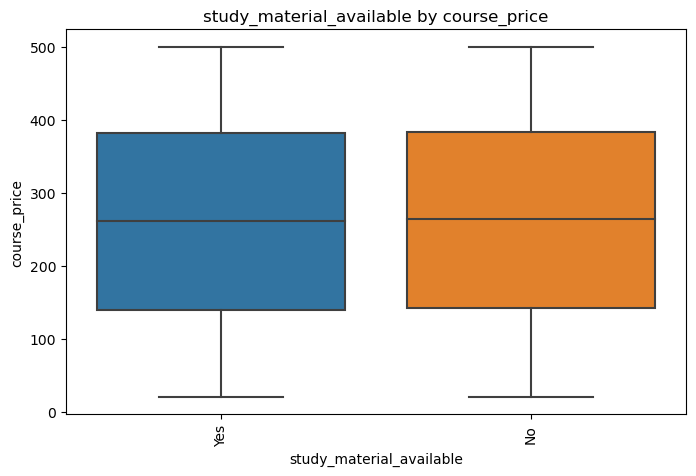

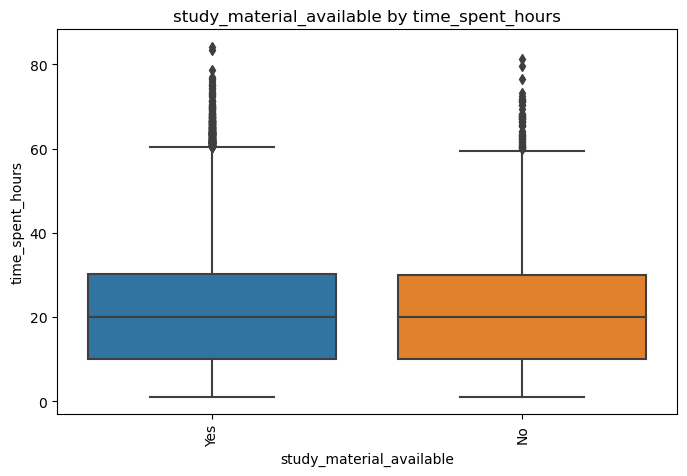

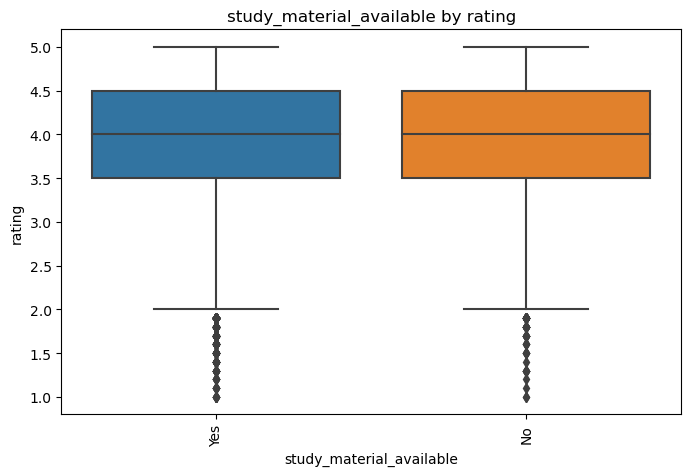

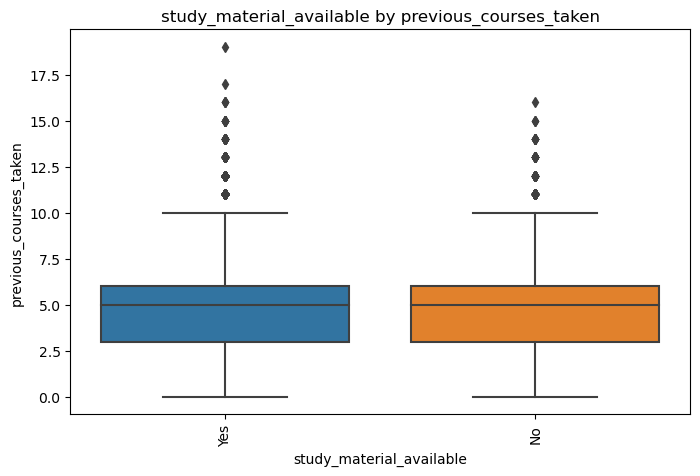

In [32]:
for col in categorical_cols:
  for i in numerical_cols:
    plt.figure(figsize=(8,5))
    sns.boxplot(x= col, y= i, data=df)
    plt.title(f"{col} by {i}")
    plt.xticks(rotation=90)
    plt.show()

**Categorial Vs Categorial**

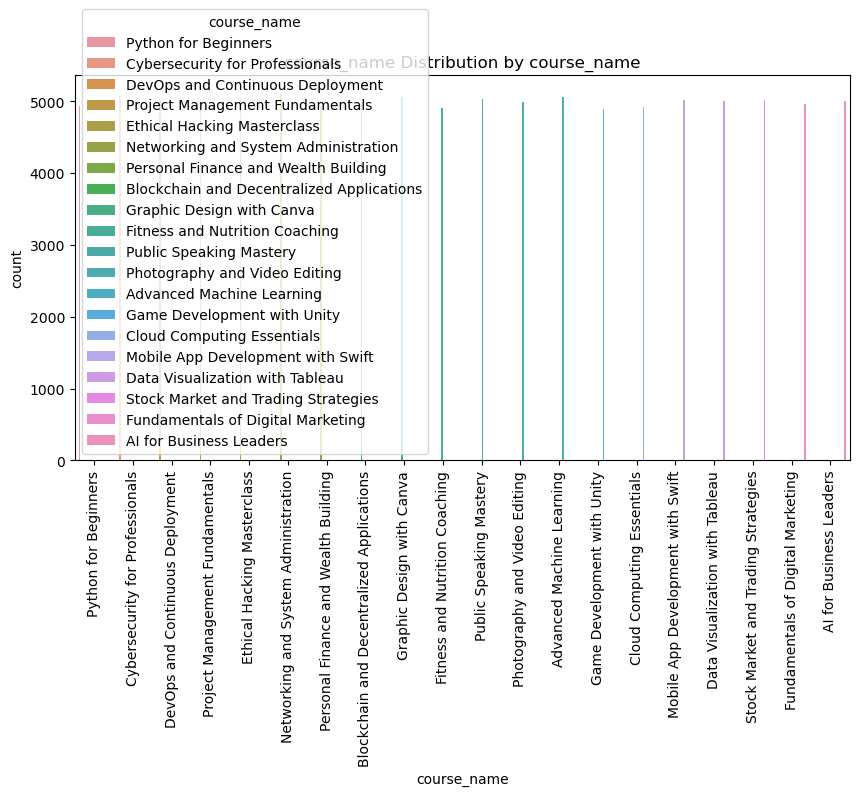

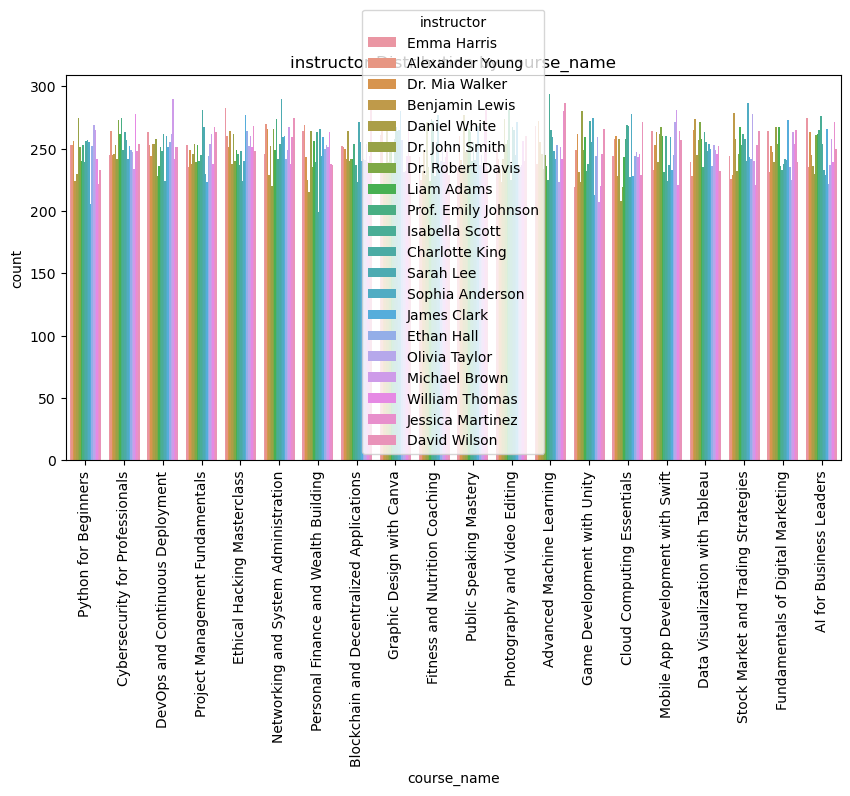

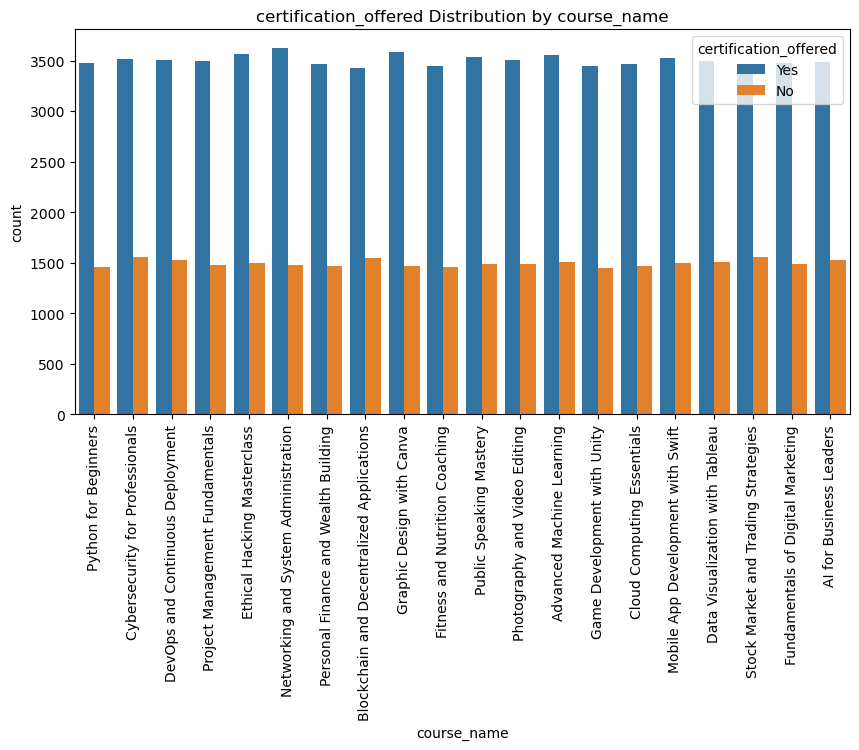

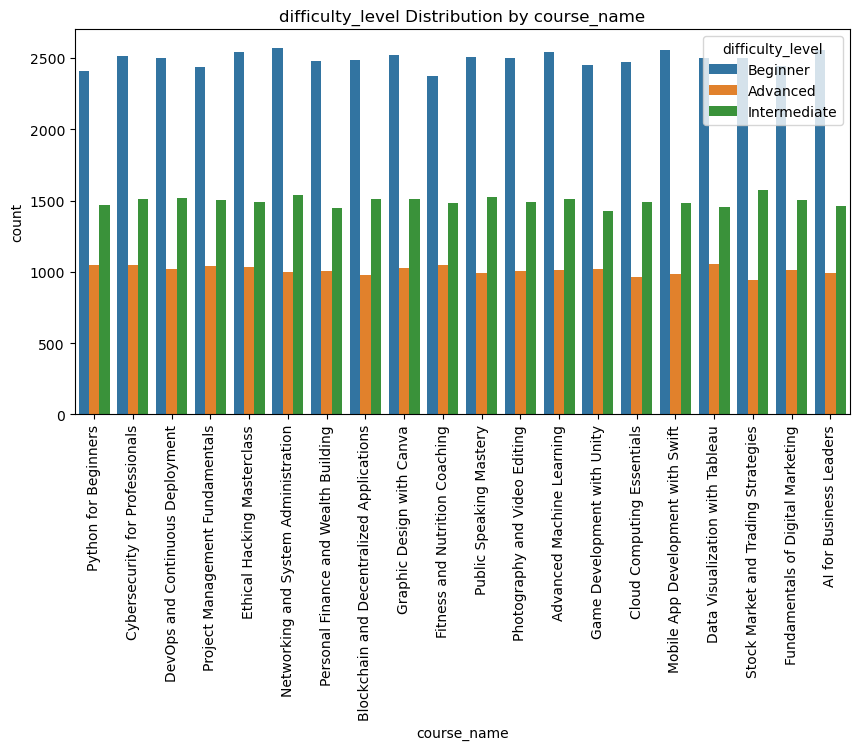

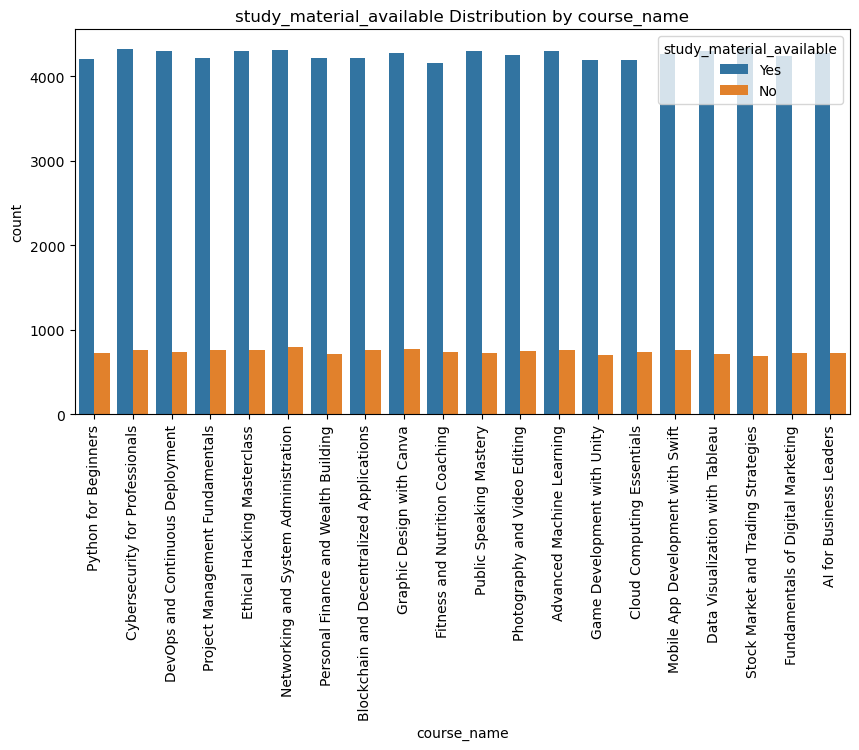

...

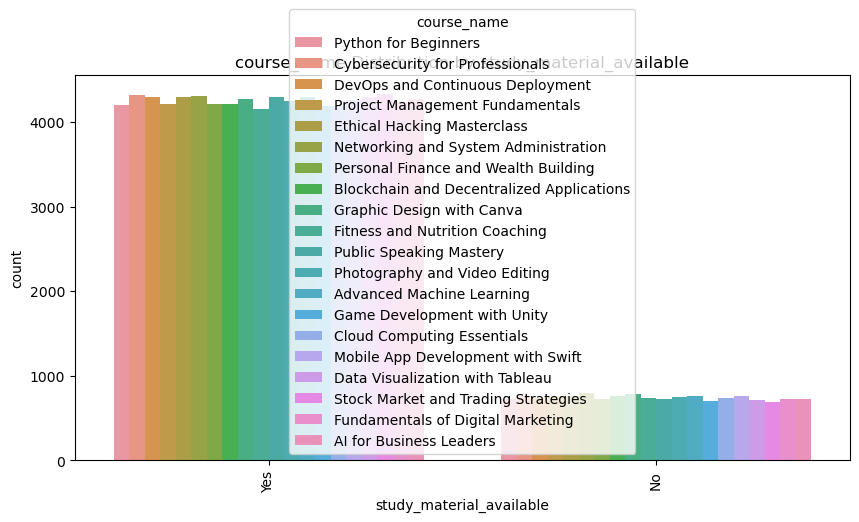

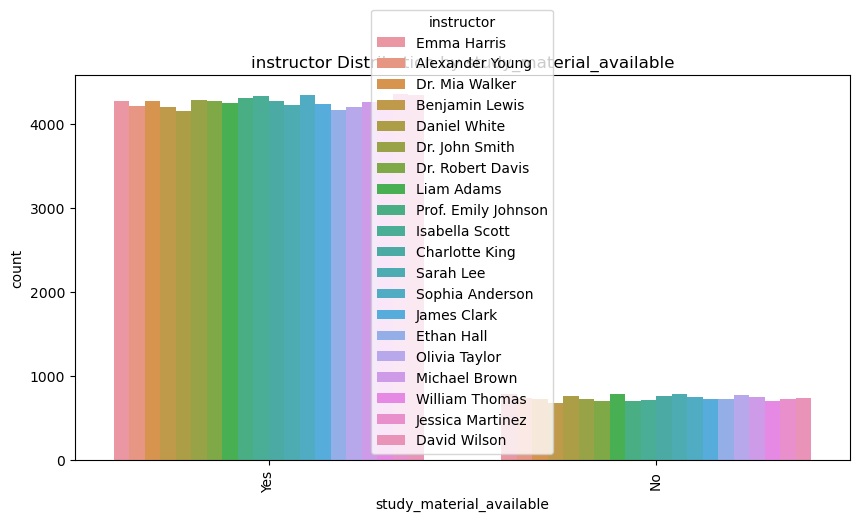

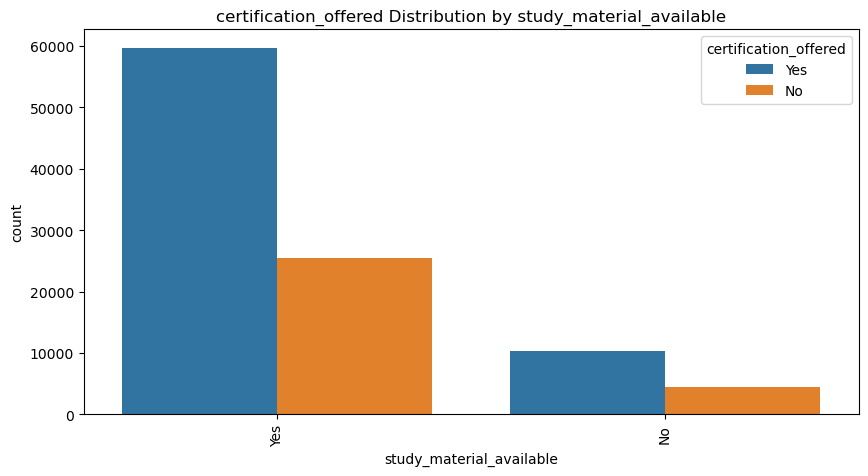

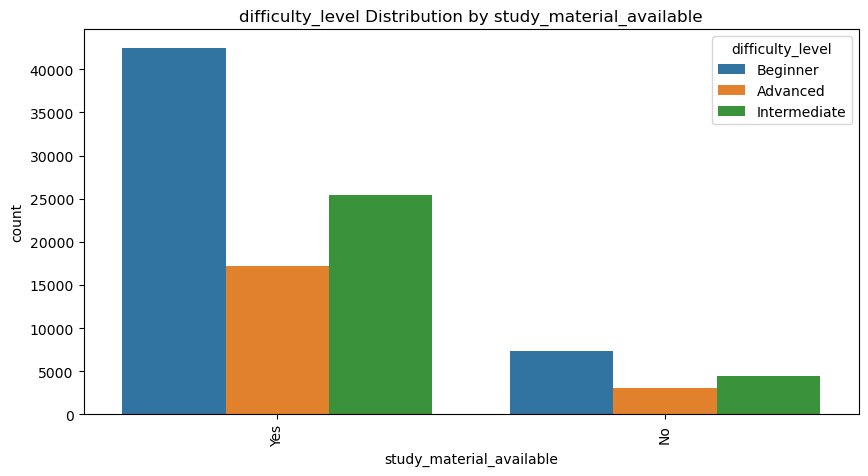

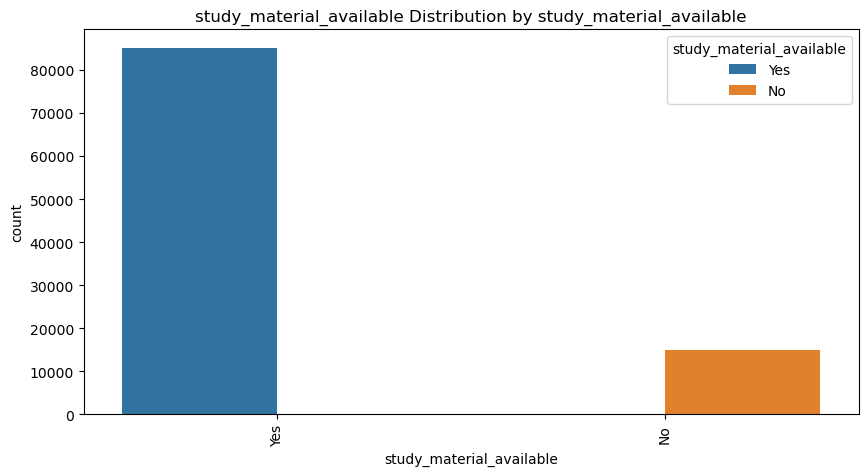

In [33]:
for cat1 in categorical_cols:
  for cat2 in categorical_cols:
    plt.figure(figsize=(10, 5))
    sns.countplot(x=cat1, hue=cat2, data=df)
    plt.xticks(rotation=90)  # Rotate x labels if needed
    plt.title(f"{cat2} Distribution by {cat1}")
    plt.show()

## **iii)Multivarient Analysis**

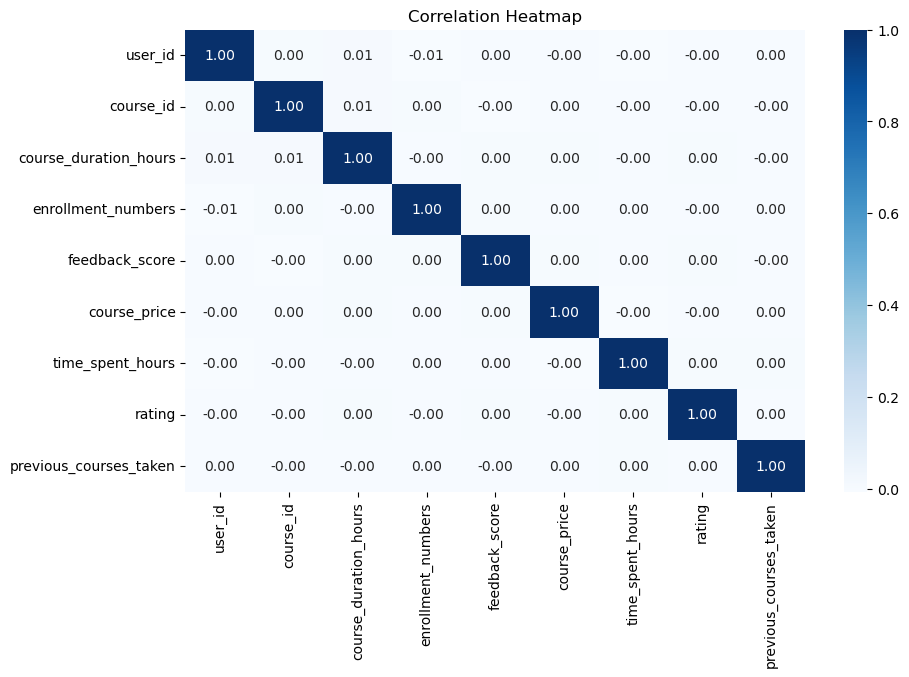

In [34]:
plt.figure(figsize=(10,6))
sns.heatmap(df[numerical_cols].corr(), annot=True, cmap="Blues", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

# **Check of missing values**

In [35]:
df.isnull().sum()

user_id                     0
course_id                   0
course_name                 0
instructor                  0
course_duration_hours       0
certification_offered       0
difficulty_level            0
rating                      0
enrollment_numbers          0
course_price                0
feedback_score              0
study_material_available    0
time_spent_hours            0
previous_courses_taken      0
dtype: int64

### **since there are no missing values we can proceed further**

In [56]:

# Remove duplicate (user_id, course_id) pairs by taking the mean rating
df = df.groupby(["user_id", "course_id", "course_name",'certification_offered','difficulty_level','study_material_available'], as_index=False).mean(numeric_only=True)
df.shape

(100000, 13)

In [57]:
df.head(15)

,user_id,course_id,course_name,certification_offered,difficulty_level,study_material_available,course_duration_hours,rating,enrollment_numbers,course_price,feedback_score,time_spent_hours,previous_courses_taken
0,1,78,Photography and Video Editing,Yes,Beginner,Yes,62.5,3.9,47116.0,431.78,0.680,37.56,4.0
1,2,621,Python for Beginners,No,Beginner,Yes,21.7,4.6,27318.0,352.27,0.873,20.46,5.0
2,2,695,Cybersecurity for Professionals,Yes,Beginner,Yes,18.3,3.6,42977.0,150.31,0.886,12.41,5.0
3,2,2021,Blockchain and Decentralized Applications,No,Advanced,Yes,13.9,4.5,41708.0,56.71,0.978,1.00,2.0
4,2,4319,Advanced Machine Learning,Yes,Beginner,Yes,15.7,3.3,15753.0,83.43,0.646,1.59,2.0
5,2,5292,Data Visualization with Tableau,Yes,Beginner,Yes,41.4,4.5,9611.0,160.56,0.805,19.89,0.0
6,3,1125,Cloud Computing Essentials,No,Beginner,Yes,24.8,4.1,26221.0,269.59,0.600,10.20,6.0
7,3,4434,Fundamentals of Digital Marketing,No,Beginner,Yes,36.2,3.7,27016.0,134.33,0.666,20.04,4.0
8,3,5381,Personal Finance and Wealth Building,Yes,Beginner,Yes,71.9,4.4,45666.0,277.95,0.829,10.67,6.0
9,3,5924,Graphic Design with Canva,Yes,Advanced,Yes,80.9,4.4,5970.0,242.31,0.900,7.77,4.0


# **Model Training & Evalution**

In [58]:

# Filter out inactive users (rated < 5 courses) and unpopular courses (rated < 5 times)
active_users = df["user_id"].value_counts()
df = df[df["user_id"].isin(active_users[active_users >= 5].index)]

popular_courses = df["course_id"].value_counts()
df = df[df["course_id"].isin(popular_courses[popular_courses >= 5].index)]

# Reset index for consistent mapping
df = df.reset_index(drop=True)

# Convert the user-course matrix to a sparse format
user_course_matrix = df.pivot(index="user_id", columns="course_id", values="rating").fillna(0)
user_course_sparse = csr_matrix(user_course_matrix)

# Compute user similarity using sparse matrices
user_sim_matrix = cosine_similarity(user_course_sparse, dense_output=False)
user_sim_df = pd.DataFrame(user_sim_matrix.toarray(), index=user_course_matrix.index, columns=user_course_matrix.index)
# Create course features using course duration, feedback score, and enrollments
df["course_features"] = (
    df["course_id"].astype(str) + " " + 
    df["course_duration_hours"].astype(str) + " " + 
    df["feedback_score"].astype(str) + " " + 
    df["enrollment_numbers"].astype(str)
)

vectorizer = TfidfVectorizer(stop_words='english')
tfidf_matrix = vectorizer.fit_transform(df["course_features"])

# Map course_id to matrix index and course names
course_id_to_index = {course_id: idx for idx, course_id in enumerate(df["course_id"].unique())}
course_id_to_name = df.set_index("course_id")["course_name"].to_dict()
course_sim_matrix = cosine_similarity(tfidf_matrix)

# Hybrid Recommendation Function (Improved)
def hybrid_recommend(user_id, top_n=5):
    if user_id not in user_sim_df.index:
        return []

    # Get top 5 most similar users (higher similarity gets more weight)
    similar_users = user_sim_df.loc[user_id].sort_values(ascending=False)[1:6]

    recommended_courses = {}
    for sim_user, sim_score in similar_users.items():
        user_courses = user_course_matrix.loc[sim_user]
        top_courses = user_courses[user_courses > 3.0].index  # Only consider courses rated > 3.0

        for course in top_courses:
            if course not in course_id_to_index:
                continue  # Skip if course_id not found
            course_idx = course_id_to_index[course]
            
            # Use weighted similarity score
            content_score = np.mean(course_sim_matrix[course_idx])
            final_score = (0.7 * sim_score) + (0.3 * content_score)  # Hybrid scoring
            
            if course in recommended_courses:
                recommended_courses[course] += final_score
            else:
                recommended_courses[course] = final_score

    # Sort by highest scores
    sorted_courses = sorted(recommended_courses.items(), key=lambda x: x[1], reverse=True)[:top_n]
    
    # Return course names along with IDs
    return [(course_id, course_id_to_name.get(course_id, "Unknown Course")) for course_id, _ in sorted_courses]

# Precision & Recall Evaluation (Improved)
def evaluate_model(test_users, top_n=5):
    precision_list = []
    recall_list = []

    for user in test_users:
        actual_courses = set(df[df["user_id"] == user]["course_id"])
        recommended_courses = set([course[0] for course in hybrid_recommend(user, top_n)])  # Extract IDs

        if len(recommended_courses) == 0 or len(actual_courses) == 0:
            continue  # Skip users with no actual or recommended courses

        relevant_recommendations = actual_courses.intersection(recommended_courses)
        precision = len(relevant_recommendations) / max(len(recommended_courses), 1)
        recall = len(relevant_recommendations) / max(len(actual_courses), 1)

        precision_list.append(precision)
        recall_list.append(recall)

    avg_precision = np.mean(precision_list) if precision_list else 0.0
    avg_recall = np.mean(recall_list) if recall_list else 0.0
    return avg_precision, avg_recall

# Run Evaluation on 100 Random Users
test_users = np.random.choice(df["user_id"].unique(), size=min(100, len(df["user_id"].unique())), replace=False)
precision, recall = evaluate_model(test_users)
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")

# Test Recommendation for a Sample User
sample_user = test_users[0]
recommendations = hybrid_recommend(sample_user, top_n=5)
print(f"\nRecommended Courses for User {sample_user}:")
for course_id, course_name in recommendations:
    print(f"- {course_name} (ID: {course_id})")

Precision: 0.5585
Recall: 0.9867

Recommended Courses for User 23071:
- Python for Beginners (ID: 131)
- AI for Business Leaders (ID: 3476)
- Mobile App Development with Swift (ID: 3173)


In [59]:
df.shape

(692, 14)

In [60]:
df.head(10)

,user_id,course_id,course_name,certification_offered,difficulty_level,study_material_available,course_duration_hours,rating,enrollment_numbers,course_price,feedback_score,time_spent_hours,previous_courses_taken,course_features
0,3,4434,Fundamentals of Digital Marketing,No,Beginner,Yes,36.2,3.7,27016.0,134.33,0.666,20.04,4.0,4434 36.2 0.666 27016.0
1,30,6507,Personal Finance and Wealth Building,Yes,Intermediate,Yes,14.0,3.9,778.0,261.35,0.686,19.70,7.0,6507 14.0 0.686 778.0
2,69,9440,Personal Finance and Wealth Building,Yes,Intermediate,Yes,46.4,4.5,16508.0,141.13,0.781,32.01,9.0,9440 46.4 0.781 16508.0
3,83,3043,Advanced Machine Learning,Yes,Beginner,Yes,24.4,4.3,26588.0,299.04,0.993,15.69,7.0,3043 24.4 0.993 26588.0
4,126,9168,Cybersecurity for Professionals,Yes,Intermediate,Yes,89.5,2.7,32609.0,50.62,0.798,21.99,5.0,9168 89.5 0.798 32609.0
5,146,211,Stock Market and Trading Strategies,Yes,Beginner,Yes,14.0,4.4,39298.0,214.47,0.688,22.42,9.0,211 14.0 0.688 39298.0
6,146,3016,Blockchain and Decentralized Applications,Yes,Beginner,Yes,43.9,3.8,24442.0,197.05,0.528,1.00,4.0,3016 43.9 0.528 24442.0
7,194,7891,Project Management Fundamentals,No,Intermediate,Yes,19.3,3.7,42110.0,100.92,0.692,17.72,4.0,7891 19.3 0.692 42110.0
8,228,1450,Advanced Machine Learning,Yes,Intermediate,Yes,93.7,1.9,49342.0,56.23,0.657,10.74,2.0,1450 93.7 0.657 49342.0
9,228,2350,Ethical Hacking Masterclass,Yes,Intermediate,Yes,48.1,4.6,11034.0,176.13,0.707,14.56,4.0,2350 48.1 0.707 11034.0
